In [1]:
import matplotlib.colors
import numpy as np
from csv_data_read_geant4 import csv_data_read
import os
import matplotlib.pyplot as plt
from SLSQP_inverse import solve_smooth_nnls
from projection_matrix_calculate import projection_matrix_calculation
# from nn_for_HERMA_inversion import CNN
#import torch
import matplotlib
import scipy.io as sio
import math
import pandas as pd
from scipy.stats import norm
import scipy.optimize as opt

In [2]:
def f_gauss(para,x):
    sigma,x_0,c,d = para
    return c/np.sqrt(2*np.pi)*np.exp(-(x-x_0)**2/2/sigma**2)+d
def residuals(para,y,x):
    return (y-f_gauss(para,x))

(37, 256)


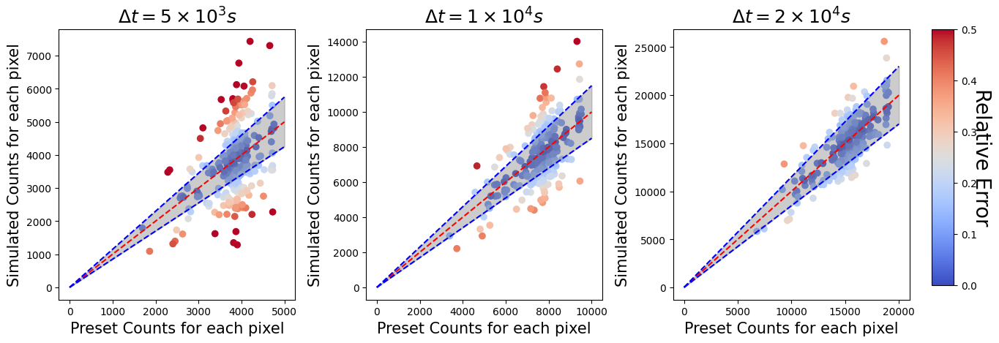

In [58]:
theta_in_deg_arr = np.linspace(-22.5, 22.5, 19)  # set input direction
phi_in_deg_arr = np.linspace(0, 90, 37)
theta_in_rad_arr = theta_in_deg_arr / 180 * math.pi
dt=1e4
sample_inca_2e4 = sio.loadmat(f"N_inca_simu_2e4_tof7.mat")['N_inca_simu']
sample_inca_1e4 = sio.loadmat(f"N_inca_simu_1e4_tof7.mat")['N_inca_simu']
sample_inca_5e3 = sio.loadmat(f"N_inca_simu_5e3_tof7.mat")['N_inca_simu']
j_inca_interp_1 = sio.loadmat("j_ena_interp_1.mat")["j_interp"] * np.cos(theta_in_rad_arr) * (
                    13.5 - 5.2) * 2 * np.sin(1.25 * np.pi / 180) * 2.5 * np.pi / 180 * dt *12
angle_source = np.arange(-22.5,25,2.5)
projection_matrix_nc = projection_matrix_calculation(angle_source)
print(sample_inca_2e4.shape)
sample_inca_theoretical = np.matmul(projection_matrix_nc, j_inca_interp_1.sum(axis=0))
fig, axes = plt.subplots(1,3,figsize=(15,5))
ax=axes[0]

error_5e3 = np.abs(sample_inca_theoretical/2 - sample_inca_5e3.sum(axis=0))/(sample_inca_theoretical/2)

s1=ax.scatter(sample_inca_theoretical/2, sample_inca_5e3.sum(axis=0),c=error_5e3,cmap='coolwarm',vmin=0,vmax=0.5)
ax.plot([0,1e4/2],[0,1e4/2],'r--')
x_range_0 = np.linspace(0, 1e4/2, 100)
ax.fill_between(x_range_0, 0.85*x_range_0, 1.15*x_range_0, alpha=0.4, color='gray')
ax.plot([0,1e4/2],[0,0.85*1e4/2],'b--')
ax.plot([0,1e4/2],[0,1.15*1e4/2],'b--')
ax.set_xlabel('Preset Counts for each pixel', fontsize=15)
ax.set_ylabel('Simulated Counts for each pixel', fontsize=15)
ax.set_title(r"$\Delta t=5 \times 10^3 s$", fontsize=18)
ax=axes[1]

error_1e4 = np.abs(sample_inca_theoretical- sample_inca_1e4.sum(axis=0))/(sample_inca_theoretical)

s2=ax.scatter(sample_inca_theoretical, sample_inca_1e4.sum(axis=0),c=error_1e4,cmap='coolwarm',vmin=0,vmax=0.5)
ax.plot([0,1e4],[0,1e4],'r--')
x_range_1 = np.linspace(0, 1e4, 100)
ax.fill_between(x_range_1, 0.85*x_range_1, 1.15*x_range_1, alpha=0.4, color='gray')
ax.plot([0,1e4],[0,0.85*1e4],'b--')
ax.plot([0,1e4],[0,1.15*1e4],'b--')
ax.set_xlabel('Preset Counts for each pixel', fontsize=15)
ax.set_ylabel('Simulated Counts for each pixel', fontsize=15)
ax.set_title(r"$\Delta t=1 \times 10^4 s$", fontsize=18)
ax=axes[2]

error_2e4 = np.abs(sample_inca_theoretical*2 - sample_inca_2e4.sum(axis=0))/(sample_inca_theoretical*2)
s3=ax.scatter(sample_inca_theoretical*2, sample_inca_2e4.sum(axis=0),c=error_2e4,cmap='coolwarm',vmin=0,vmax=0.5)
ax.plot([0,2e4],[0,2e4],'r--')
x_range_2 = np.linspace(0, 2e4, 100)
ax.fill_between(x_range_2, 0.85*x_range_2, 1.15*x_range_2, alpha=0.4, color='gray')
ax.plot([0,2e4],[0,0.85*2e4],'b--')
ax.plot([0,2e4],[0,1.15*2e4],'b--')
ax.set_xlabel('Preset Counts for each pixel', fontsize=15)
ax.set_ylabel('Simulated Counts for each pixel', fontsize=15)

# 添加共享colorbar在右侧
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(s3, cax=cbar_ax)
cbar.set_label('Relative Error', rotation=270, labelpad=15, fontsize=20)
ax.set_title(r"$\Delta t=2 \times 10^4 s$", fontsize=18)

# 调整subplot布局为右侧留出空间
fig.subplots_adjust(right=0.9,wspace=0.3,top=0.85)

# plt.plot(sample_inca_theoretical/sample_inca_theoretical.sum(), label='Theoretical')
# plt.plot(sample_inca_2e4.sum(axis=0)/sample_inca_2e4.sum(axis=0).sum(), label='Simulated')
# plt.plot(sample_inca_1e4.sum(axis=0)/sample_inca_1e4.sum(axis=0).sum(), label='Simulated 1e4')
# plt.plot(sample_inca_5e3.sum(axis=0)/sample_inca_5e3.sum(axis=0).sum(), label='Simulated 5e3')

(37, 256)


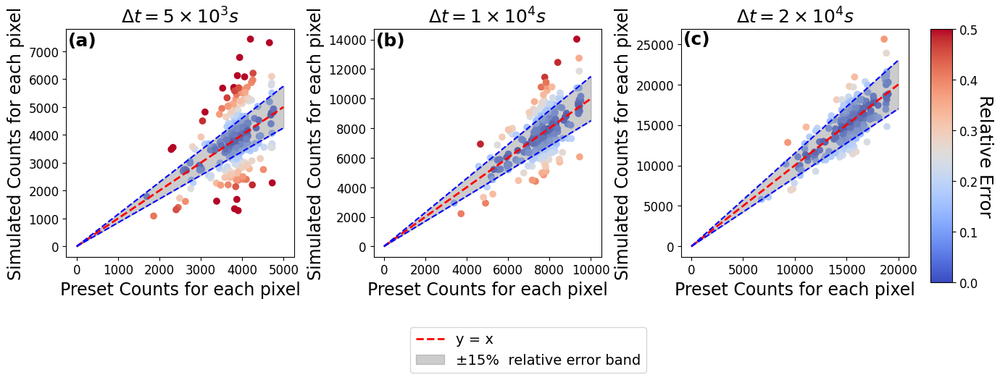

In [76]:
theta_in_deg_arr = np.linspace(-22.5, 22.5, 19)  # set input direction
phi_in_deg_arr = np.linspace(0, 90, 37)
theta_in_rad_arr = theta_in_deg_arr / 180 * math.pi
dt=1e4
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
sample_inca_2e4 = sio.loadmat(f"N_inca_simu_2e4_tof7.mat")['N_inca_simu']
sample_inca_1e4 = sio.loadmat(f"N_inca_simu_1e4_tof7.mat")['N_inca_simu']
sample_inca_5e3 = sio.loadmat(f"N_inca_simu_5e3_tof7.mat")['N_inca_simu']
j_inca_interp_1 = sio.loadmat("j_ena_interp_1.mat")["j_interp"] * np.cos(theta_in_rad_arr) * (
                    13.5 - 5.2) * 2 * np.sin(1.25 * np.pi / 180) * 2.5 * np.pi / 180 * dt *12
angle_source = np.arange(-22.5,25,2.5)
projection_matrix_nc = projection_matrix_calculation(angle_source)
print(sample_inca_2e4.shape)
sample_inca_theoretical = np.matmul(projection_matrix_nc, j_inca_interp_1.sum(axis=0))
fig, axes = plt.subplots(1,3,figsize=(15,5))
ax=axes[0]

error_5e3 = np.abs(sample_inca_theoretical/2 - sample_inca_5e3.sum(axis=0))/(sample_inca_theoretical/2)

s1=ax.scatter(sample_inca_theoretical/2, sample_inca_5e3.sum(axis=0),c=error_5e3,cmap='coolwarm',vmin=0,vmax=0.5)
line1 = ax.plot([0,1e4/2],[0,1e4/2],'r--', linewidth=2, label='y = x')[0]
x_range_0 = np.linspace(0, 1e4/2, 100)
fill1 = ax.fill_between(x_range_0, 0.85*x_range_0, 1.15*x_range_0, alpha=0.4, color='gray', label='±15% error band')
ax.plot([0,1e4/2],[0,0.85*1e4/2],'b--')
ax.plot([0,1e4/2],[0,1.15*1e4/2],'b--')
ax.set_xlabel('Preset Counts for each pixel', fontsize=17)
ax.set_ylabel('Simulated Counts for each pixel', fontsize=17)
ax.set_title(r"$\Delta t=5 \times 10^3 s$", fontsize=18)
ax.text(-200,7200,'(a)', fontsize=18, fontweight='bold')

ax=axes[1]

error_1e4 = np.abs(sample_inca_theoretical- sample_inca_1e4.sum(axis=0))/(sample_inca_theoretical)

s2=ax.scatter(sample_inca_theoretical, sample_inca_1e4.sum(axis=0),c=error_1e4,cmap='coolwarm',vmin=0,vmax=0.5)
ax.plot([0,1e4],[0,1e4],'r--', linewidth=2)
x_range_1 = np.linspace(0, 1e4, 100)
ax.fill_between(x_range_1, 0.85*x_range_1, 1.15*x_range_1, alpha=0.4, color='gray')
ax.plot([0,1e4],[0,0.85*1e4],'b--')
ax.plot([0,1e4],[0,1.15*1e4],'b--')
ax.set_xlabel('Preset Counts for each pixel', fontsize=17)
ax.set_ylabel('Simulated Counts for each pixel', fontsize=17)
ax.set_title(r"$\Delta t=1 \times 10^4 s$", fontsize=18)
ax.text(-400,13600,'(b)', fontsize=18, fontweight='bold')
ax=axes[2]

error_2e4 = np.abs(sample_inca_theoretical*2 - sample_inca_2e4.sum(axis=0))/(sample_inca_theoretical*2)
s3=ax.scatter(sample_inca_theoretical*2, sample_inca_2e4.sum(axis=0),c=error_2e4,cmap='coolwarm',vmin=0,vmax=0.5)
ax.plot([0,2e4],[0,2e4],'r--', linewidth=2)
x_range_2 = np.linspace(0, 2e4, 100)
ax.fill_between(x_range_2, 0.85*x_range_2, 1.15*x_range_2, alpha=0.4, color='gray')
ax.plot([0,2e4],[0,0.85*2e4],'b--')
ax.plot([0,2e4],[0,1.15*2e4],'b--')
ax.set_xlabel('Preset Counts for each pixel', fontsize=17)
ax.set_ylabel('Simulated Counts for each pixel', fontsize=17)
ax.set_title(r"$\Delta t=2 \times 10^4 s$", fontsize=18)
ax.text(-800,25000,'(c)', fontsize=18, fontweight='bold')
# 添加共享colorbar在右侧
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
cbar = fig.colorbar(s3, cax=cbar_ax)
cbar.set_label('Relative Error', rotation=270, labelpad=15, fontsize=18)

# 在所有子图下方添加统一的legend
fig.legend([line1, fill1], ['y = x', '±15%  relative error band'], 
          loc='lower center', ncol=1, bbox_to_anchor=(0.55, -0.12), fontsize=14, frameon=True)

# 调整subplot布局为右侧和下方留出空间
fig.subplots_adjust(right=0.9, wspace=0.35, top=0.85, bottom=0.22)

# plt.plot(sample_inca_theoretical/sample_inca_theoretical.sum(), label='Theoretical')
# plt.plot(sample_inca_2e4.sum(axis=0)/sample_inca_2e4.sum(axis=0).sum(), label='Simulated')
# plt.plot(sample_inca_1e4.sum(axis=0)/sample_inca_1e4.sum(axis=0).sum(), label='Simulated 1e4')
# plt.plot(sample_inca_5e3.sum(axis=0)/sample_inca_5e3.sum(axis=0).sum(), label='Simulated 5e3')

In [25]:
data_dir = f"D://Research/Codes/HERMA-ENA/csv_belt_test_fine/"
data_total_fine = np.zeros((451,256))
for index in range(451):
    data_basename0 = f"ENAImagerTest_nt_ENAImagerTest_t0_"
    data_basename1 = f"ENAImagerTest_nt_ENAImagerTest_t1_"
    data_total_fine[index,:] = csv_data_read(data_dir, data_basename0 + str(index) + ".csv", data_basename1 + str(index) + ".csv")

In [ ]:
angle_source = np.linspace(-22.5,22.5,46)
#plt.plot(data_total[0,:])
projection_matrix_nc = projection_matrix_calculation(angle_source)

d:\Research\Codes\HERMA-ENA\projection_matrix_calculate.py:30: GuessedAtParserWarning: No parser was explicitly specified, so I'm using the best available HTML parser for this system ("html.parser"). This usually isn't a problem, but if you run this code on another system, or in a different virtual environment, it may use a different parser and behave differently.

The code that caused this warning is on line 30 of the file d:\Research\Codes\HERMA-ENA\projection_matrix_calculate.py. To get rid of this warning, pass the additional argument 'features="html.parser"' to the BeautifulSoup constructor.

  soup = BeautifulSoup(content)
d:\Research\Codes\HERMA-ENA\projection_matrix_calculate.py:30: XMLParsedAsHTMLWarning: It looks like you're using an HTML parser to parse an XML document.

Assuming this really is an XML document, what you're doing might work, but you should know that using an XML parser will be more reliable. To parse this document as XML, make sure you have the Python package

Text(-23, 245, '(a)')

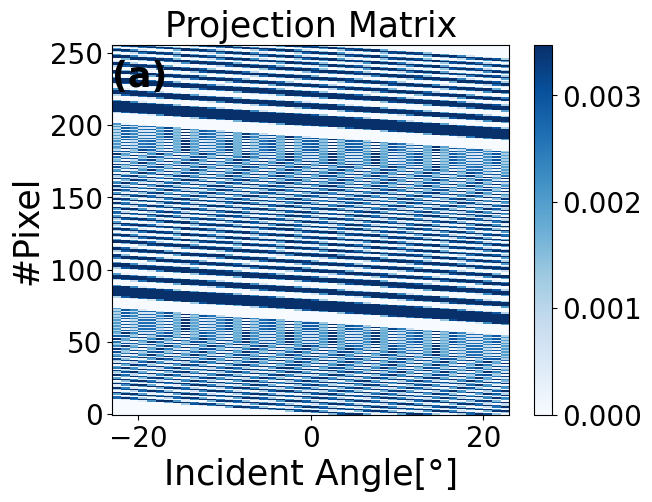

In [73]:
plt.pcolormesh(np.linspace(-22.5,22.5,46), range(256),projection_matrix_nc, cmap="Blues")
plt.ylabel("#Pixel", fontsize=25)
plt.xlabel("Incident Angle[°]", fontsize=25)
plt.title("Projection Matrix", fontsize=25)
plt.colorbar()
plt.text(-23, 245, "(a)", fontsize=25, fontweight='bold', va='top', ha='left', color='k')

Text(-10, 20000.0, '(c)')

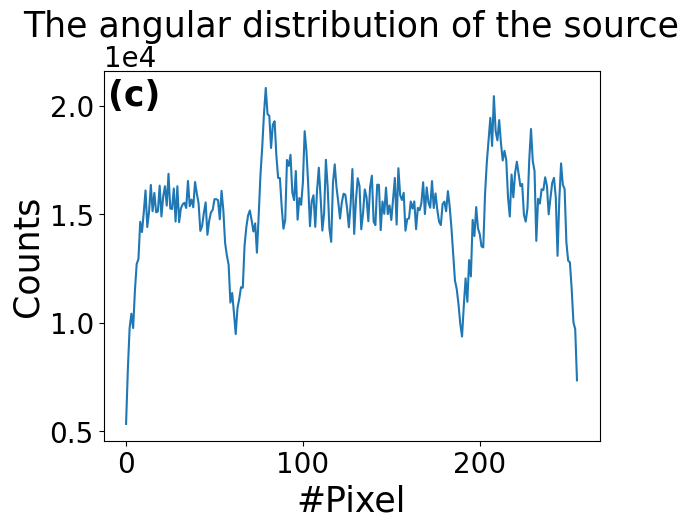

In [78]:
plt.rcParams['xtick.labelsize'] = 20
plt.rcParams['ytick.labelsize'] = 20
angle_source = np.linspace(-22.5,22.5,451)
factor_arr = np.sin(np.radians(8*angle_source))+np.cos(2*np.radians(angle_source))+3*np.sin(np.radians(angle_source)+45)


#plt.plot(angle_source[::10], (factor_arr*data_total_fine.sum(axis=1))[::10])
plt.plot(data_total_fine[::10,:].sum(axis=0))
#plt.xlabel("Incident Angle[°]", fontsize=25)
plt.xlabel("#Pixel", fontsize=25)
plt.ylabel("Counts", fontsize=25)
plt.title("The angular distribution of the source", fontsize=25)
plt.ticklabel_format(axis='y', style='scientific', scilimits=(0, 0))
plt.text(-10,2e4,"(c)", fontsize=25, fontweight="bold")

(256, 451)
(256, 451)
(256, 451)
(256, 451)


Text(-10, 720, '(h)')

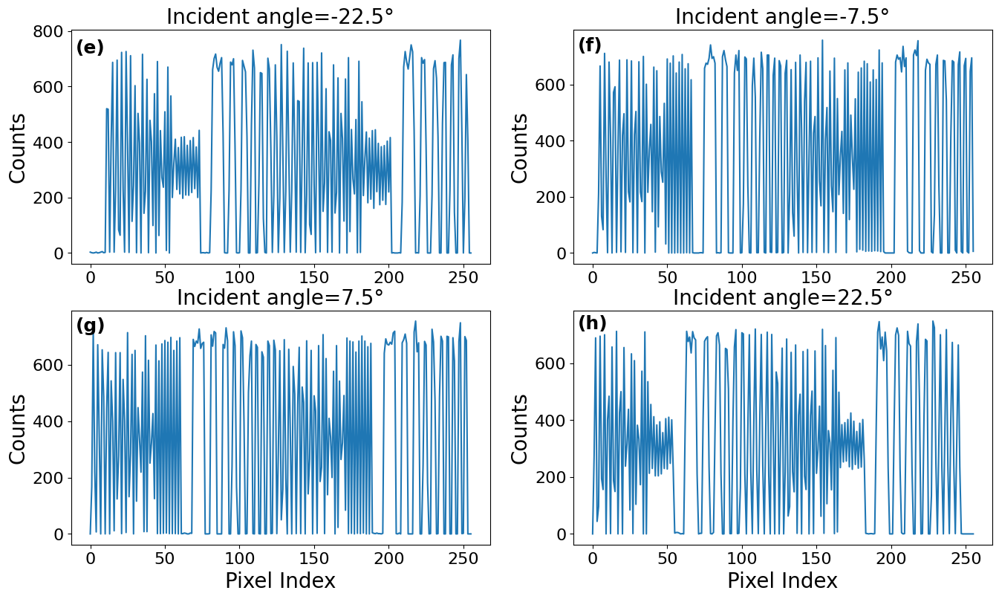

In [39]:
fig,axes=plt.subplots(2,2,figsize=(16,9))
ax =axes[0][0]
ax.tick_params(axis='x', labelsize=16)
ax.tick_params(axis='y', labelsize=16)
#ax.set_yticks(fontsize=16)
ax.plot(data_total_fine[0,:])
#plt.hist(data_total_fine[0,:], bins=np.linspace(0,255,256))
print(projection_martix_nc.shape)
#plt.plot(2e5*projection_martix_nc[:,0])
#ax.set_xlabel('Pixel Index', fontsize=20)
ax.set_ylabel('Counts', fontsize=20)
ax.set_title('Incident angle=-22.5°', fontsize=20)
ax.text(-10,720,'(e)', fontsize=18,fontweight='bold')
ax =axes[0][1]
ax.tick_params(axis='x', labelsize=16)
ax.tick_params(axis='y', labelsize=16)
#ax.set_yticks(fontsize=16)
ax.plot(data_total_fine[150,:])
#plt.hist(data_total_fine[0,:], bins=np.linspace(0,255,256))
print(projection_martix_nc.shape)
#plt.plot(2e5*projection_martix_nc[:,0])
#ax.set_xlabel('Pixel Index', fontsize=20)
ax.set_ylabel('Counts', fontsize=20)
ax.set_title('Incident angle=-7.5°', fontsize=20)
ax.text(-10,720,'(f)', fontsize=18,fontweight='bold')
ax =axes[1][0]
ax.tick_params(axis='x', labelsize=16)
ax.tick_params(axis='y', labelsize=16)
#ax.set_yticks(fontsize=16)
ax.plot(data_total_fine[300,:])
#plt.hist(data_total_fine[0,:], bins=np.linspace(0,255,256))
print(projection_martix_nc.shape)
#plt.plot(2e5*projection_martix_nc[:,0])
ax.set_xlabel('Pixel Index', fontsize=20)
ax.set_ylabel('Counts', fontsize=20)
ax.set_title('Incident angle=7.5°', fontsize=20)
ax.text(-10,720,'(g)', fontsize=18,fontweight='bold')
ax =axes[1][1]
ax.tick_params(axis='x', labelsize=16)
ax.tick_params(axis='y', labelsize=16)
#ax.set_yticks(fontsize=16)
ax.plot(data_total_fine[450,:])
#plt.hist(data_total_fine[0,:], bins=np.linspace(0,255,256))
print(projection_martix_nc.shape)
#plt.plot(2e5*projection_martix_nc[:,0])
ax.set_xlabel('Pixel Index', fontsize=20)
ax.set_ylabel('Counts', fontsize=20)
ax.set_title('Incident angle=22.5°', fontsize=20)
ax.text(-10,720,'(h)', fontsize=18,fontweight='bold')



In [10]:
data_dir = f"D://Research/Codes/HERMA-ENA/csv_belt_test_wide/"
data_total = np.zeros((61,256))
for index in range(61):
    data_basename0 = f"ENAImagerTest_nt_ENAImagerTest_t0_"
    data_basename1 = f"ENAImagerTest_nt_ENAImagerTest_t1_"
    data_total[index,:] = csv_data_read(data_dir, data_basename0 + str(index) + ".csv", data_basename1 + str(index) + ".csv")

Text(0.5, 1.0, '$\\Delta theta=1\\degree$, $\\sum G(\\theta)$=0.342 $cm^2\\ sr$')

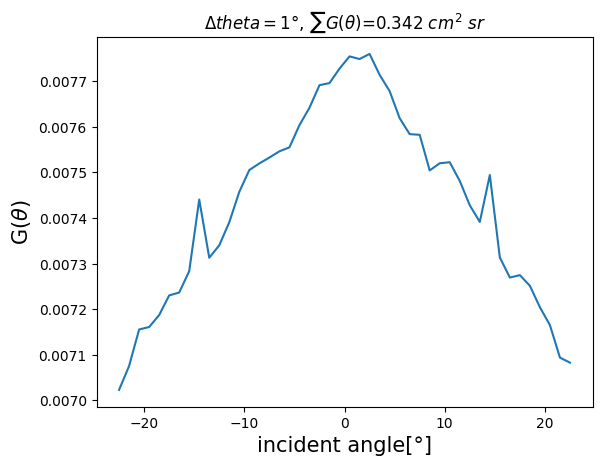

In [78]:
delta_omega = 2*np.sin(0.5*np.pi/180)*np.pi/180*2.5
plt.plot(angle_source,data_total.sum(axis=1)/5e5*delta_omega*115.4*20/1e2)
plt.xlabel("incident angle[°]",fontsize=15)
plt.ylabel(r"G($\theta$)",fontsize=15)
plt.title(rf"$\Delta theta=1\degree$, $\sum G(\theta)$={data_total.sum()/5e5*delta_omega*115.4*20/1e2:.3f} $cm^2\ sr$")

In [16]:
fake_data_mat_00 = np.zeros((16, 4096, 256, 2))
fake_data_mat_01 = np.zeros((16, 4096, 256, 2))
fake_data_mat_10 = np.zeros((16, 4096, 256, 2))
fake_data_mat_11_32 = np.zeros((16, 32, 256, 128))
fake_data_mat_11_8 = np.zeros((16, 8, 256, 512))
energy_bin_4096 = np.linspace(0,4095,4096)*0.25-400
energy_bin_32 = np.zeros(32)
energy_bin_32[0] = 5
energy_bin_32[-1] = 550
energy_bin_32[1:-1] = np.logspace(np.log10(10),np.log10(500),30)
theta_arr = np.linspace(-np.pi/180*22.5,22.5*np.pi/180,46)
phi_arr = np.linspace(0,np.pi/2,37)

In [18]:
def calc_direction_factor(theta,phi):
    lambda_0 = 3.4
    r = 10
    theta_to_H = np.arccos(np.cos(phi)*np.sin(theta))
    if np.abs(theta_to_H)<1e-4:
        return np.exp(-lambda_0/r)
    return np.exp(-lambda_0/r*(theta_to_H)/np.sin(theta_to_H))


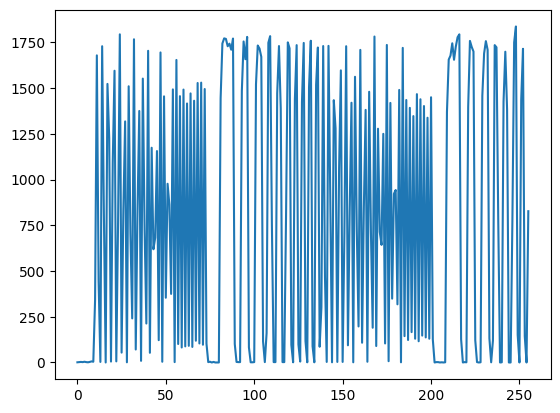

In [53]:
plt.plot(data_total[1,:])

In [37]:
intense_lst = [1, 1.2, 1.4, 1.6, 1.5, 1.3]
fake_data_mat_00 = np.zeros((16, 4096, 256, 2))
for i_img in range(2):
    for i_det in range(16):
        for i_ern in range(len(energy_bin_4096)):
            
            for i_theta in range(46):
                theta_tmp = -theta_arr[i_theta]+(22.5+45*(i_det%4))*np.pi/180
                factor_tmp = calc_direction_factor(theta_tmp, i_det//4*np.pi/2)
                if i_det==0:
                    print(theta_tmp, factor_tmp)
                    
                
                if energy_bin_4096[i_ern]>=5 and energy_bin_4096[i_ern]<=550:
                    # if np.abs(factor_tmp)>1:
                    #     print(factor_tmp, i_theta)
                    fake_data_mat_00[i_det, i_ern,:,i_img] += intense_lst[i_img]*factor_tmp*(energy_bin_4096[i_ern]/100)**(-1.5)*data_total[i_theta,:]/10/25

0.7853981633974483 0.685473766578965
0.767944870877505 0.6842224099797639
0.7504915783575616 0.6829370633220294
0.7330382858376183 0.6816172624679063
0.7155849933176751 0.680262528611025
0.6981317007977318 0.678872367935191
0.6806784082777885 0.6774462712612825
0.6632251157578453 0.6759837136820512
0.6457718232379019 0.6744841541845159
0.6283185307179586 0.6729470352596374
0.6108652381980153 0.6713717824989529
0.593411945678072 0.6697578041778475
0.5759586531581287 0.6681044908251383
0.5585053606381855 0.6664112147786423
0.5410520681182421 0.6646773297263984
0.5235987755982989 0.6629021702332166
0.5061454830783556 0.6610850512522272
0.48869219055841223 0.6592252676211052
0.47123889803846897 0.657322093542654
0.45378560551852565 0.6553747820494364
0.4363323129985824 0.6533825644521527
0.41887902047863906 0.6513446497714775
0.4014257279586958 0.6492602241530835
0.3839724354387525 0.6471284502655986
0.36651914291880916 0.6449484666812683
0.3490658503988659 0.642719387239119
0.331612557878

In [143]:
print(fake_data_mat_00.max())
print(energy_bin_4096[1620])
fake_data_mat_00_int = np.round(fake_data_mat_00).astype(np.int32)
print(fake_data_mat_00_int[:,3800, :, 0].max())

19497.198633715117
5.0
14


In [38]:
fake_data_mat_01= np.zeros((16, 4096, 256, 2))
for i_img in range(2,4):
    for i_det in range(16):
        for i_ern in range(len(energy_bin_4096)):
            for i_theta in range(46):
                theta_tmp = -theta_arr[i_theta]+(22.5+45*(i_det%4))*np.pi/180
                factor_tmp = calc_direction_factor(theta_tmp,(i_det//4)*np.pi/2)
                if energy_bin_4096[i_ern]>=5 and energy_bin_4096[i_ern]<=550:
                    if factor_tmp>1:
                        print(factor_tmp, i_theta)
                    fake_data_mat_01[i_det, i_ern,:, i_img-2] +=intense_lst[i_img]*factor_tmp*(energy_bin_4096[i_ern]/100)**(-1.5)*data_total[i_theta,:]/10/25

In [39]:
fake_data_mat_10 = np.zeros((16, 4096, 256, 2))
for i_img in range(4,6):
    for i_det in range(16):
        for i_ern in range(len(energy_bin_4096)):
            for i_theta in range(46):
                theta_tmp = -theta_arr[i_theta]+(22.5+45*(i_det%4))*np.pi/180
                factor_tmp = calc_direction_factor(theta_tmp,(i_det//4)*np.pi/2)
                if energy_bin_4096[i_ern]>=5 and energy_bin_4096[i_ern]<=550:
                    fake_data_mat_10[i_det, i_ern, :, i_img-4] += intense_lst[i_img]*factor_tmp*(energy_bin_4096[i_ern]/100)**(-1.5)*data_total[i_theta,:]/10/25

In [ ]:
intense_lst_11 = [1, 0.5, 2]
fake_data_mat_11_32 = np.zeros((16, 32, 256, 128))
theta_arr = np.linspace(-np.pi/180*30,30*np.pi/180,61)
phi_arr = np.linspace(0,np.pi/2,37)
for i_bag in range(108):
    for i_det in range(16):
        for i_ern in range(len(energy_bin_32)):
            for i_theta in range(61):
                theta_tmp = -theta_arr[i_theta]+(22.5+45*(i_det%4))*np.pi/180
                phi_tmp = phi_arr[i_bag%36]
                factor_tmp = calc_direction_factor(theta_tmp, i_det//4*np.pi/2+phi_tmp+np.pi/2*(i_bag//36))

                fake_data_mat_11_32[i_det, i_ern, :, i_bag] += intense_lst_11[i_bag//36]*factor_tmp*(energy_bin_32[i_ern]/100)**(-1.5)*data_total[i_theta,:]/10/25

In [30]:

data_test = fake_data_mat_11_32[:,0, :, :36]
data_test_sub = fake_data_mat_11_32[10, 0, :, 0]




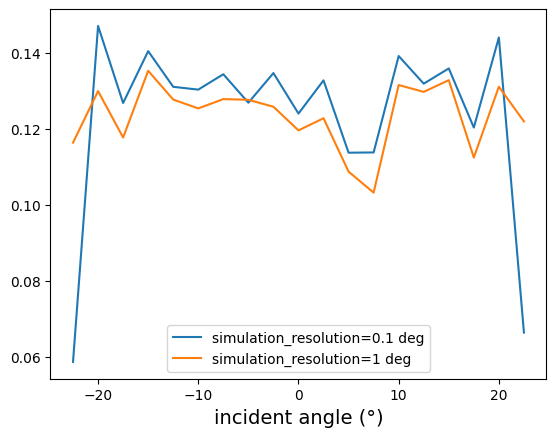

In [33]:
angle_source = np.linspace(-22.5,22.5, 19)
projection_matrix = projection_matrix_calculation(angle_source)
angle_source_fine = np.linspace(-22.5,22.5, 46)
projection_matrix_fine = projection_matrix_calculation(angle_source_fine)
source_fine = solve_smooth_nnls(projection_matrix.T, data_total_fine.sum(axis=0)/data_total_fine.sum(),0,S_initial=np.ones(19))
source = solve_smooth_nnls(projection_matrix.T, data_total.sum(axis=0)/data_total.sum(),0,S_initial=np.ones(19))
# source_2 = solve_smooth_nnls(projection_matrix_fine.T, data_total_fine[200,:]/data_total[20,:].sum(),0,S_initial=np.ones(len(angle_source_fine)))
plt.plot(angle_source, source_fine, label='simulation_resolution=0.1 deg')
plt.plot(angle_source, source, label='simulation_resolution=1 deg')
# plt.plot(angle_source_fine, source_2, label='simulation_resolution=0.5 deg')
plt.xlabel("incident angle (°)" , fontsize=14)


plt.legend()

In [41]:
i_plot = 9

data_inverse_mat = np.zeros((76, 144))
for i in range(36):
    for i_det in range(16):
        data_inverse_mat[(i_det%4)*19:(i_det%4+1)*19, i+36*(i_det//4)] = solve_smooth_nnls(projection_matrix.T, data_test[i_det,:,i]/data_test[i_det, :, i].sum(), 0, S_initial=np.ones(19))[::-1]*data_test[i_det, :, i].sum()


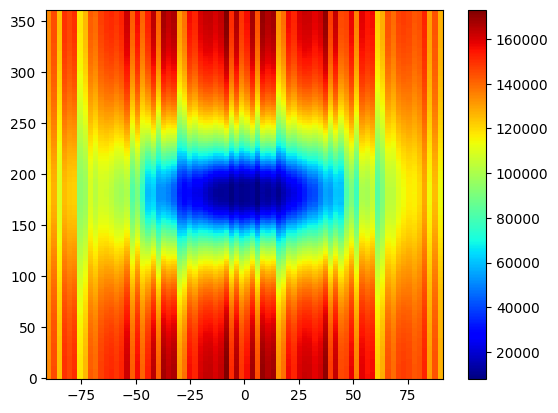

In [43]:
lon = np.linspace(0, 360, 144)
lat = np.linspace(-90, 90, 76)
plt.pcolormesh(lat, lon, data_inverse_mat.T, cmap='jet')
plt.colorbar()

In [41]:
fake_data_mat_11_8 = np.zeros((16, 8, 256, 512))
for i_bag in range(504):
    for i_ern in range(8):
        fake_data_mat_11_8[:,i_ern, :, i_bag] = np.sum(fake_data_mat_11_32[:,i_ern*4:i_ern*4+4, :, i_bag//14],axis=1)

In [152]:
print(fake_data_mat_11_32.max())

32495.331056191862


In [42]:
fake_data_mat_00_int = np.round(fake_data_mat_00).astype(np.int32)
fake_data_mat_01_int = np.round(fake_data_mat_01).astype(np.int32)
fake_data_mat_10_int = np.round(fake_data_mat_10).astype(np.int32)
fake_data_mat_11_32_int = np.round(fake_data_mat_11_32).astype(np.int32)
fake_data_mat_11_8_int = np.round(fake_data_mat_11_8).astype(np.int32)

C:\Users\mrwwn\AppData\Local\Temp\ipykernel_3860\3474720474.py:5: RuntimeWarning: divide by zero encountered in log10
  pclr=ax.pcolormesh(range(256),energy_bin_4096, np.log10(fake_data_mat_00[4*i+j,:,:,0]), cmap='jet', vmin=0.5, vmax=4.2)


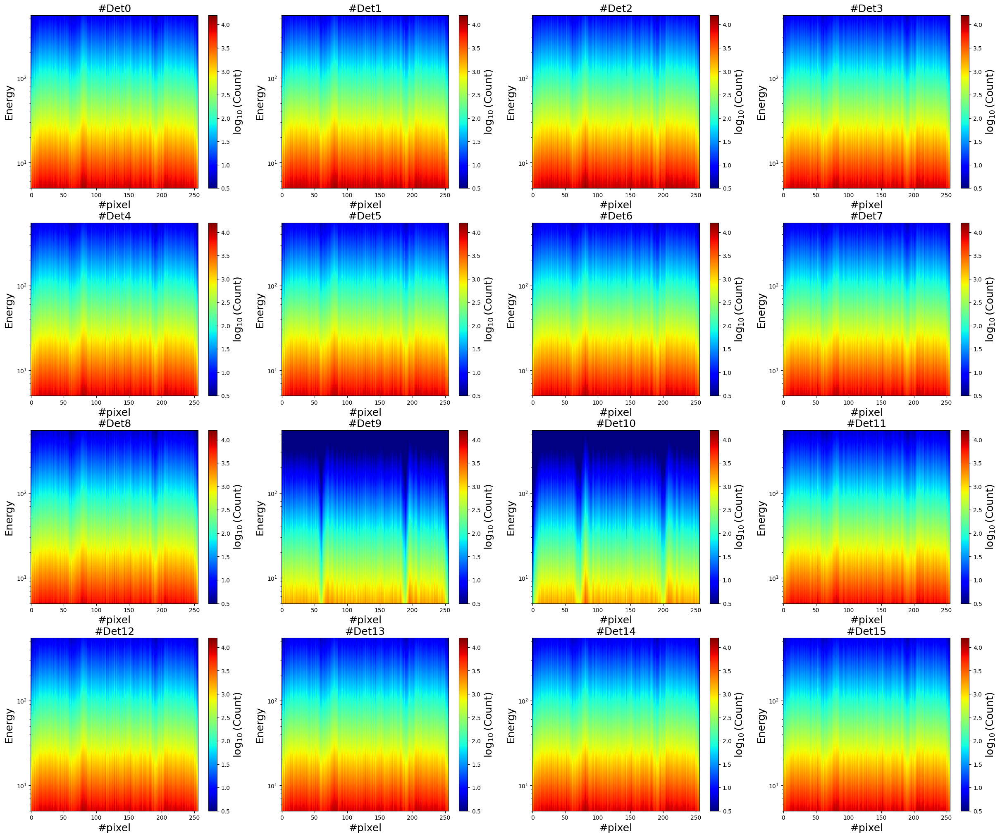

In [185]:
fig, axes = plt.subplots(4, 4, figsize=(30, 25))
for i in range(4):
    for j in range(4):
        ax = axes[i, j]
        pclr=ax.pcolormesh(range(256),energy_bin_4096, np.log10(fake_data_mat_00[4*i+j,:,:,0]), cmap='jet', vmin=0.5, vmax=4.2)
        cbar=plt.colorbar(pclr, ax=ax)
        cbar.set_label(r"$\log_{10}$(Count)", fontsize=18)
        ax.set_ylim([5,550])
        ax.set_xlabel('#pixel', fontsize=18)
        ax.set_ylabel('Energy', fontsize=18)
        ax.set_yscale('log')
        ax.set_title(f'#Det{4*i+j}', fontsize=18)

In [43]:
import numpy as np
import struct

# # 假设已定义以下数组（根据题目给出的初始化）
# fake_data_mat_00 = np.zeros((16, 4096, 256, 2), dtype=np.uint16)  # p0文件：16探头×4096能档×256通道×2包
# fake_data_mat_01 = np.zeros((16, 4096, 256, 2), dtype=np.uint16)  # p1文件：16探头×4096能档×256通道×2包
# fake_data_mat_10 = np.zeros((16, 4096, 256, 2), dtype=np.uint16)  # p2文件：16探头×4096能档×256通道×2包
# fake_data_mat_11_32 = np.zeros((16, 32, 256, 128), dtype=np.uint16)  # p3文件32能档部分：16探头×32能档×256通道×128包
# fake_data_mat_11_8 = np.zeros((16, 8, 256, 512), dtype=np.uint16)  # p3文件8能档部分：16探头×8能档×256通道×512包

# ASIC通道到像素编号的映射（文档提供的OrderLs数组，完整还原）
OrderLs = [
    191, 187, 189, 185, 181, 183, 179, 175, 177, 173, 169, 171, 167, 163, 165, 161,
    157, 159, 155, 151, 153, 149, 145, 147, 143, 139, 141, 137, 133, 135, 131, 127,
    253, 255, 251, 247, 249, 245, 241, 243, 239, 235, 237, 233, 229, 231, 227, 223,
    225, 221, 217, 219, 215, 211, 213, 209, 205, 207, 203, 199, 201, 197, 193, 195,
    61, 63, 59, 55, 57, 53, 49, 51, 47, 43, 45, 41, 37, 39, 35, 31,
    33, 29, 25, 27, 23, 19, 21, 17, 13, 15, 11, 7, 9, 5, 1, 3,
    129, 125, 121, 123, 119, 115, 117, 113, 109, 111, 107, 103, 105, 101, 97, 99,
    95, 91, 93, 89, 85, 87, 83, 79, 81, 77, 73, 75, 71, 67, 69, 65,
    194, 186, 190, 188, 180, 184, 182, 174, 178, 176, 168, 172, 170, 162, 166, 164,
    156, 160, 158, 150, 154, 152, 144, 148, 146, 138, 142, 140, 132, 136, 134, 126,
    252, 256, 254, 246, 250, 248, 240, 244, 242, 234, 238, 236, 228, 232, 230, 222,
    226, 224, 216, 220, 218, 210, 214, 212, 204, 208, 206, 198, 202, 200, 192, 196,
    60, 64, 62, 54, 58, 56, 48, 52, 50, 42, 46, 44, 36, 40, 38, 30,
    34, 32, 24, 28, 26, 18, 22, 20, 12, 16, 14, 6, 10, 8, 2, 4,
    130, 128, 120, 124, 122, 114, 118, 116, 108, 112, 110, 102, 106, 104, 96, 100,
    98, 90, 94, 92, 84, 88, 86, 78, 82, 80, 72, 76, 74, 66, 70, 68
]

def write_bin_files():
    """
    按文档要求写入所有64个二进制文件（16探头×4文件/探头）
    """
    # 定义文件映射：(文件后缀, 对应数组, 数据类型标识)
    file_mappings = [
        ("p0", fake_data_mat_00_int, "4096道"),
        ("p1", fake_data_mat_01_int, "4096道"),
        ("p2", fake_data_mat_10_int, "4096道"),
        ("p3", (fake_data_mat_11_32_int, fake_data_mat_11_8_int), "32能档+8能档")
    ]
    
    for probe_idx in range(16):  # 遍历16个探头（0~15）
        probe_num = probe_idx  # 探头编号：1~16（文档命名用d01~d16）
        probe_str = f"d{probe_num:02d}"  # 格式化为d01, d02,...d16
        
        for file_suffix, data, data_type in file_mappings:
            # 生成文件名：datasample_dxx_px.bin
            filename = f"datasample_{probe_str}_{file_suffix}.bin"
            print(f"正在写入文件：{filename} ({data_type})")
            
            if data_type == "4096道":
                # 处理p0/p1/p2文件：4096能档×256通道×2包
                # 数据维度：[探头, 能档(0~4095), 通道(0~255), 包(0~1)]
                probe_data = data[probe_idx]  # (4096, 256, 2)
                
                # 按文档要求排序：先按包→能档→通道（需转换为像素顺序）
                output_data = bytearray()  # 使用bytearray更高效
                for packet in range(2):  # 2个包，依次输出
                    for asic_ch in range(256):
                        for energy in range(4096):  # 0~4095能档
                          # 0~255 ASIC通道
                            # 获取该通道对应的像素数据（uint16）
                            pixel_value = probe_data[energy, asic_ch, packet]
                            # 用struct打包为大端字节序（>H表示大端无符号短整数）
                            big_endian_bytes = struct.pack('>H', pixel_value)
                            output_data.extend(big_endian_bytes)
                
                # 写入文件
                with open(filename, 'wb') as f:
                    f.write(output_data)
            
            else:  # 处理p3文件：32能档(128包) + 8能档(512包)
                data_32, data_8 = data
                # 32能档数据：[探头, 能档(0~31), 通道(0~255), 包(0~127)]
                probe_32 = data_32[probe_idx]  # (32, 256, 128)
                # 8能档数据：[探头, 能档(0~7), 通道(0~255), 包(0~511)]
                probe_8 = data_8[probe_idx]    # (8, 256, 512)
                
                output_data = bytearray()
                
                # 先写入32能档所有包（0~127）
                for packet in range(128):
                    for asic_ch in range(256):
                        for energy in range(32):
                        
                            pixel_value = probe_32[energy, asic_ch, packet]
                            output_data.extend(struct.pack('>H', pixel_value))
                
                # 再写入8能档所有包（0~511）
                for packet in range(512):
                    for asic_ch in range(256):
                
                        for energy in range(8):
                        
                            pixel_value = probe_8[energy, asic_ch, packet]
                            output_data.extend(struct.pack('>H', pixel_value))
                
                # 写入文件
                with open(filename, 'wb') as f:
                    f.write(output_data)
    
    print("所有64个文件写入完成！")

def verify_file_sizes():
    """
    验证生成的文件大小是否符合文档要求（4MB/文件）
    """
    import os
    print("\n开始验证文件大小...")
    expected_size = 4 * 1024 * 1024  # 4MB
    all_correct = True
    
    for probe_idx in range(16):
        probe_num = probe_idx
        probe_str = f"d{probe_num:02d}"
        for suffix in ["p0", "p1", "p2", "p3"]:
            filename = f"datasample_{probe_str}_{suffix}.bin"
            if os.path.exists(filename):
                actual_size = os.path.getsize(filename)
                if actual_size != expected_size:
                    print(f"⚠️  文件{filename}大小错误：实际{actual_size}字节，期望{expected_size}字节")
                    all_correct = False
            else:
                print(f"⚠️  文件{filename}不存在！")
                all_correct = False
    
    if all_correct:
        print("✅ 所有文件大小验证通过！")

# 执行文件写入
write_bin_files()

# 可选：验证文件大小（建议执行）
verify_file_sizes()

正在写入文件：datasample_d00_p0.bin (4096道)
正在写入文件：datasample_d00_p1.bin (4096道)
正在写入文件：datasample_d00_p2.bin (4096道)
正在写入文件：datasample_d00_p3.bin (32能档+8能档)
正在写入文件：datasample_d01_p0.bin (4096道)
正在写入文件：datasample_d01_p1.bin (4096道)
正在写入文件：datasample_d01_p2.bin (4096道)
正在写入文件：datasample_d01_p3.bin (32能档+8能档)
正在写入文件：datasample_d02_p0.bin (4096道)
正在写入文件：datasample_d02_p1.bin (4096道)
正在写入文件：datasample_d02_p2.bin (4096道)
正在写入文件：datasample_d02_p3.bin (32能档+8能档)
正在写入文件：datasample_d03_p0.bin (4096道)
正在写入文件：datasample_d03_p1.bin (4096道)
正在写入文件：datasample_d03_p2.bin (4096道)
正在写入文件：datasample_d03_p3.bin (32能档+8能档)
正在写入文件：datasample_d04_p0.bin (4096道)
正在写入文件：datasample_d04_p1.bin (4096道)
正在写入文件：datasample_d04_p2.bin (4096道)
正在写入文件：datasample_d04_p3.bin (32能档+8能档)
正在写入文件：datasample_d05_p0.bin (4096道)
正在写入文件：datasample_d05_p1.bin (4096道)
正在写入文件：datasample_d05_p2.bin (4096道)
正在写入文件：datasample_d05_p3.bin (32能档+8能档)
正在写入文件：datasample_d06_p0.bin (4096道)
正在写入文件：datasample_d06_p1.bin (4096道)
正在写入文件：datasample_d0

4.25
[ 3.88593249e+00  2.73231748e-03  4.17226355e+04 -1.91200757e+03]


C:\Users\mrwwn\AppData\Local\Temp\ipykernel_11132\859832635.py:7: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


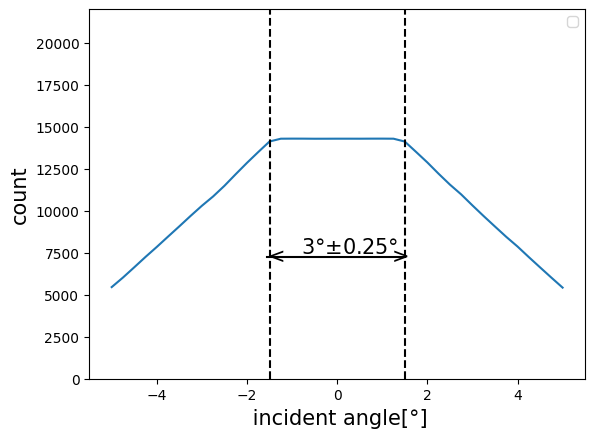

In [28]:
plt.plot(np.linspace(-5,5,41),np.sum(data_total, axis=1))#,label='simulation result')
plt.xlabel(" incident angle[°]", fontsize=15)
plt.ylabel("count", fontsize=15)
initial_para=np.array([2.5, 0, 1e4, 0])
para = opt.leastsq(residuals,initial_para,args=(np.sum(data_total, axis=1),np.linspace(-5,5,41)))
# plt.plot(np.linspace(-5,5,41),f_gauss(para[0], np.linspace(-5,5,41)),label='gaussian fitting')
plt.legend()
#plt.text(-5,17500, fr'FWHM={2.355*para[0][0]:.2f}°', fontsize=15)
#plt.text(-5,20000, fr'$\sigma$={para[0][0]:.2f}°,', fontsize=15)
idx_half=np.argmin(np.abs(np.sum(data_total, axis=1)-0.5*np.sum(data_total, axis=1)[20]))
print(np.linspace(-5,5,41)[idx_half])
half_peak = np.sum(data_total, axis=1)[idx_half]
plt.axvline(-1.5,c='k',ls='--')
plt.axvline(1.5,c='k',ls='--')
# plt.plot([0,3],[half_peak,half_peak],'--k')
# plt.plot([0,0],[0,np.sum(data_total, axis=1)[20]],'--k')
plt.text(-1.55,half_peak-300,'<', fontsize=15)
plt.text(1.2,half_peak-300,'>', fontsize=15)
plt.plot([-1.55,1.5],[half_peak,half_peak],'-k')
plt.text(-0.8,7500, fr'3°$\pm$0.25°', fontsize=15)
# plt.plot([3,3],[0,half_peak],'--k')
# plt.text(3.1,3000,'half peak', fontsize=11)
#plt.text(-4,17000, f'c={np.sum(data_total):.0f
plt.ylim([0,22000])
print(para[0])

d:\Research\Codes\HERMA-ENA\projection_matrix_calculate.py:30: GuessedAtParserWarning: No parser was explicitly specified, so I'm using the best available HTML parser for this system ("html5lib"). This usually isn't a problem, but if you run this code on another system, or in a different virtual environment, it may use a different parser and behave differently.

The code that caused this warning is on line 30 of the file d:\Research\Codes\HERMA-ENA\projection_matrix_calculate.py. To get rid of this warning, pass the additional argument 'features="html5lib"' to the BeautifulSoup constructor.

  soup = BeautifulSoup(content)
d:\Research\Codes\HERMA-ENA\projection_matrix_calculate.py:30: XMLParsedAsHTMLWarning: It looks like you're parsing an XML document using an HTML parser. If this really is an HTML document (maybe it's XHTML?), you can ignore or filter this warning. If it's XML, you should know that using an XML parser will be more reliable. To parse this document as XML, make sure yo

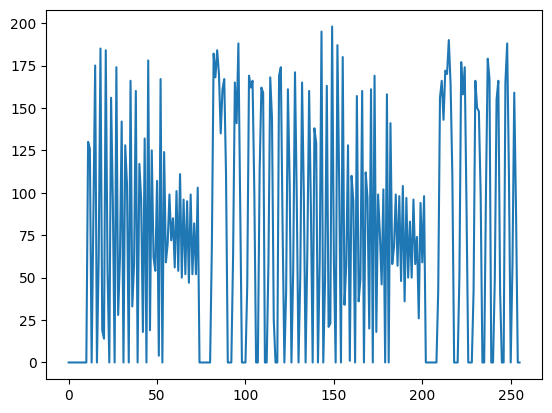

In [27]:
angle_source = np.linspace(-22.5,22.5,451)
plt.plot(data_total[0,:])
projection_martix_nc = projection_matrix_calculation(angle_source)


In [38]:
i_plot = 6
for i_plot in range(19):
    source = solve_smooth_nnls(projection_martix_nc.T, data_total[i_plot,:]/data_total[i_plot,:].sum(), 0.0, np.ones(len(angle_source)))
    # print(source.shape)
    # plt.plot(angle_source, source*data_total[i_plot,:].sum())
    # plt.xlabel("angle_i", fontsize=15)
    # plt.ylabel("reversed counts",fontsize=15)
    sort_index = np.argsort(np.abs(source-source.max()/2))
    # print(np.abs(angle_source[sort_index[1]]-angle_source[sort_index[0]]))
    print(f"入射角={-22.5+i_plot*2.5:.1f}deg, 半峰宽={np.abs(angle_source[sort_index[1]]-angle_source[sort_index[0]]):.2f}deg")

入射角=-22.5deg, 半峰宽=27.20deg
入射角=-20.0deg, 半峰宽=0.60deg
入射角=-17.5deg, 半峰宽=0.60deg
入射角=-15.0deg, 半峰宽=0.60deg
入射角=-12.5deg, 半峰宽=0.10deg
入射角=-10.0deg, 半峰宽=0.60deg
入射角=-7.5deg, 半峰宽=0.50deg
入射角=-5.0deg, 半峰宽=0.50deg
入射角=-2.5deg, 半峰宽=0.60deg
入射角=0.0deg, 半峰宽=0.60deg
入射角=2.5deg, 半峰宽=0.50deg
入射角=5.0deg, 半峰宽=0.50deg
入射角=7.5deg, 半峰宽=0.50deg
入射角=10.0deg, 半峰宽=0.50deg
入射角=12.5deg, 半峰宽=0.70deg
入射角=15.0deg, 半峰宽=0.60deg
入射角=17.5deg, 半峰宽=0.60deg
入射角=20.0deg, 半峰宽=0.60deg
入射角=22.5deg, 半峰宽=34.60deg
